In [1]:
import pandas as pd
import polars as pl
import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns

from sklearn.decomposition import PCA, FastICA

import torch
from torch.utils.data import DataLoader, Dataset

from mne.preprocessing import ICA

from scipy import signal
from scipy.ndimage import median_filter


from src.styles import *
set_styles()

In [2]:
def target_status(row):
    num_annot = row.iloc[-6:].sum()
    if (num_annot < 3):
        return 'weak'
    
    row = row.iloc[-6:] / num_annot
    delta = 2. / num_annot
    if (row.iloc[-6:] == 1).any():
        return 'ideal'
    elif (row['other_vote'] >= (0.5 - delta)) & (row['other_vote'] <= (0.5 + delta)) & (row.iloc[-6:-1] == (1. - row['other_vote'])).any():
        return 'proto'
    elif (row['other_vote'] < delta):
        for i in range(2, 7):
            cur = row.iloc[-i]
            if (cur >= (0.5 - delta)) & (cur <= (0.5 + delta)):
                if ((row.iloc[-6:-i] == (1. - cur)).any()) | ((row.iloc[-i+1:-1] == (1. - cur)).any()):
                    return 'edge'
                
    return 'weak'

In [3]:
path = 'data/train.csv'
df = pd.read_csv(path).sort_values(['eeg_id', 'eeg_label_offset_seconds'])
dif = df['eeg_label_offset_seconds'] - df['eeg_label_offset_seconds'].shift(1)
df = df.loc[~((dif > 0) & (dif < 50))].reset_index(drop=True) # use only different events

num_annotators = df.iloc[:, -6:].sum(axis=1)
status = df.apply(lambda row: target_status(row), axis=1)

df.insert(df.shape[1] - 7, 'num_annotators', num_annotators)
df.insert(df.shape[1] - 7, 'status', status)
df

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,num_annotators,status,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,568657,0,0.0,789577333,0,0.0,1825637311,20654,12,weak,Other,0,0,3,0,2,7
1,582999,0,0.0,1552638400,0,0.0,1722186807,20230,14,weak,LPD,0,12,0,1,0,1
2,642382,0,0.0,14960202,12,1008.0,3254468733,5955,1,weak,Other,0,0,0,0,0,1
3,751790,0,0.0,618728447,4,908.0,2898467035,38549,1,weak,GPD,0,0,1,0,0,0
4,778705,0,0.0,52296320,0,0.0,3255875127,40955,2,weak,Other,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17084,4293354003,0,0.0,1188113564,0,0.0,447244163,16610,2,weak,GRDA,0,0,0,0,1,1
17085,4293843368,0,0.0,1549502620,0,0.0,1618953053,15065,2,weak,GRDA,0,0,0,0,1,1
17086,4294455489,0,0.0,2105480289,0,0.0,469526364,56,1,weak,Other,0,0,0,0,0,1
17087,4294858825,0,0.0,657299228,0,0.0,561576493,4312,15,weak,Other,0,0,0,0,1,14


In [4]:
SR = 200
LEN_SEC = 50
DPI=100

def display_eegs(data, label, offset=0):

    df = data.loc[int(offset*SR): int((offset+LEN_SEC)*SR), :]

    fig, ax = plt.subplots(1,1, figsize=(16, 6), dpi=100)

    # display all channels
    for i, col in enumerate(df.columns):
        sns.lineplot(x=np.linspace(0, df.shape[0] // SR, df.shape[0]), y=df[col] / 10 + i, color='black', ax=ax, alpha=0.5, linewidth=1)
        ax.text(-3, i, col)

    # highlight event
    h = df.shape[1] - 1
    w = LEN_SEC
    rect=mpatches.Rectangle((0.4*w,-1),0.2*w,h + 1*2, facecolor=PALETTE[0], alpha=0.3)
    ax.add_patch(rect)

    ax.set_xticks(np.arange(0, 50, 10), np.arange(0, 50, 10))
    ax.grid(axis='x')
        
    ax.set_xlabel('seconds')
    ax.set_ylabel('')
    ax.set_yticklabels([])

    ax.set_title(label, loc='center')
    
    plt.tight_layout()
    plt.show()

In [5]:
def get_diagnosis(dict):
    res = ''
    for k,v in dict.items():
        if v > 0:
            res += '| ' + k[:-5] + ' ' + str(v) + ' |'
    return res

In [6]:
N_EXAMPLES = 4

df_ideal = df.loc[df['status'] == 'ideal'] \
    .sort_values(['expert_consensus', 'num_annotators'], ascending=False) \
    .groupby('expert_consensus') \
    .head(N_EXAMPLES)
df_ideal

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,num_annotators,status,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
8399,2088807520,0,0.0,198643605,0,0.0,2493314214,40881,16,ideal,Seizure,16,0,0,0,0,0
12152,3030710864,0,0.0,388803499,0,0.0,2569163393,14965,16,ideal,Seizure,16,0,0,0,0,0
932,241433122,0,0.0,2058601455,0,0.0,663904781,4863,15,ideal,Seizure,15,0,0,0,0,0
3191,794842413,0,0.0,1946784308,0,0.0,3303915154,24619,15,ideal,Seizure,15,0,0,0,0,0
2622,658623458,0,0.0,746484395,0,0.0,1066857183,63946,23,ideal,Other,0,0,0,0,0,23
2366,590374806,0,0.0,766843679,0,0.0,2332265795,36490,22,ideal,Other,0,0,0,0,0,22
3266,811958440,0,0.0,1863972381,0,0.0,2545608526,9223,21,ideal,Other,0,0,0,0,0,21
3738,936283997,0,0.0,1119143423,0,0.0,1615809118,1568,21,ideal,Other,0,0,0,0,0,21
10897,2713014975,0,0.0,780890284,0,0.0,3734439265,31386,10,ideal,LRDA,0,0,0,10,0,0
3358,839459106,0,0.0,995785734,2,534.0,1826634126,37979,5,ideal,LRDA,0,0,0,5,0,0


# Longitudinal montage

In [7]:
def get_double_banana_montage(eeg: pd.DataFrame) -> pd.DataFrame:
    montage = pd.DataFrame(index=eeg.index)

    # temporal chains
    montage['Fp1-F7'] = eeg['Fp1'] - eeg['F7']
    montage['F7-T3'] = eeg['F7'] - eeg['T3']
    montage['T3-T5'] = eeg['T3'] - eeg['T5']
    montage['T5-O1'] = eeg['T5'] - eeg['O1']

    montage['Fp2-F8'] = eeg['Fp2'] - eeg['F8']
    montage['F8-T4'] = eeg['F8'] - eeg['T4']
    montage['T4-T6'] = eeg['T4'] - eeg['T6']
    montage['T6-O2'] = eeg['T6'] - eeg['O2']

    # parasagittal chains
    montage['Fp1-F3'] = eeg['Fp1'] - eeg['F3']
    montage['F3-C3'] = eeg['F3'] - eeg['C3']
    montage['C3-P3'] = eeg['C3'] - eeg['P3']
    montage['P3-O1'] = eeg['P3'] - eeg['O1']

    montage['Fp2-F4'] = eeg['Fp2'] - eeg['F4']
    montage['F4-C4'] = eeg['F4'] - eeg['C4']
    montage['C4-P4'] = eeg['C4'] - eeg['P4']
    montage['P4-O2'] = eeg['P4'] - eeg['O2']

    # central chains
    montage['Fz-Cz'] = eeg['Fz'] - eeg['Cz']
    montage['Cz-Pz'] = eeg['Cz'] - eeg['Pz']

    return montage

2088807520


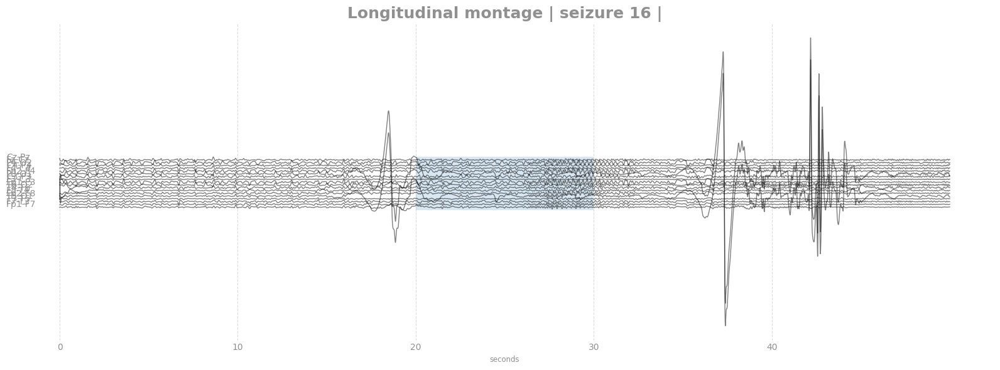

3030710864


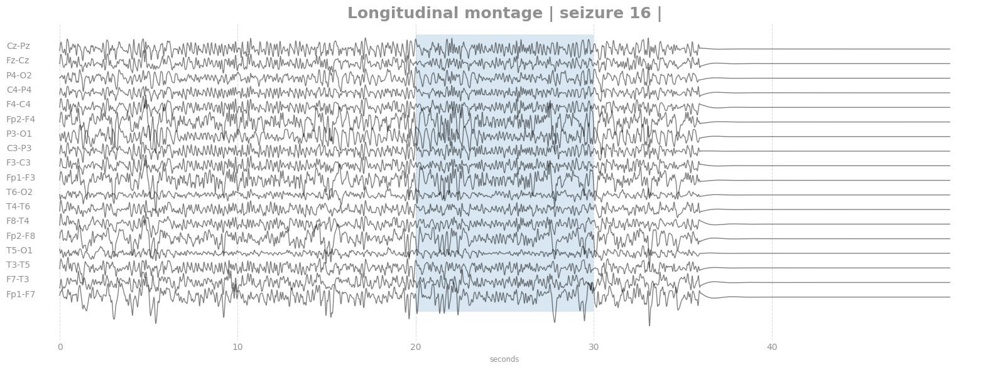

241433122


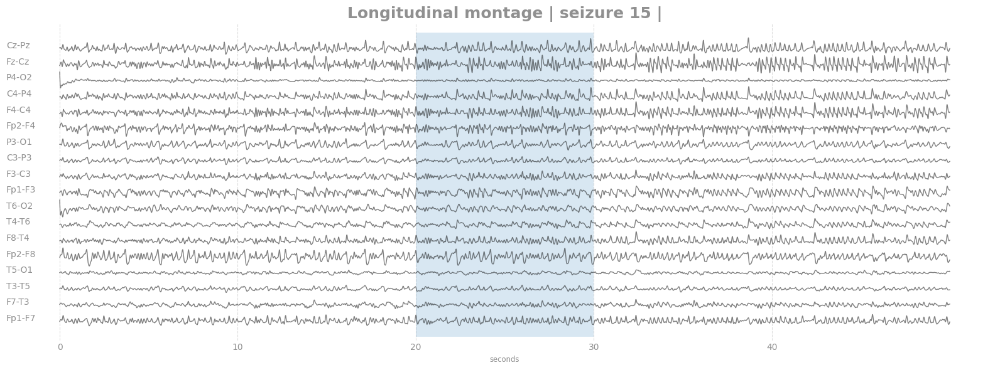

794842413


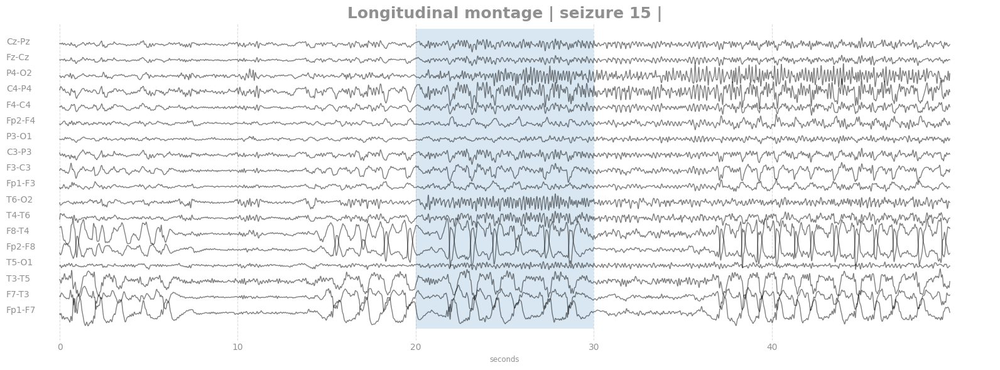

658623458


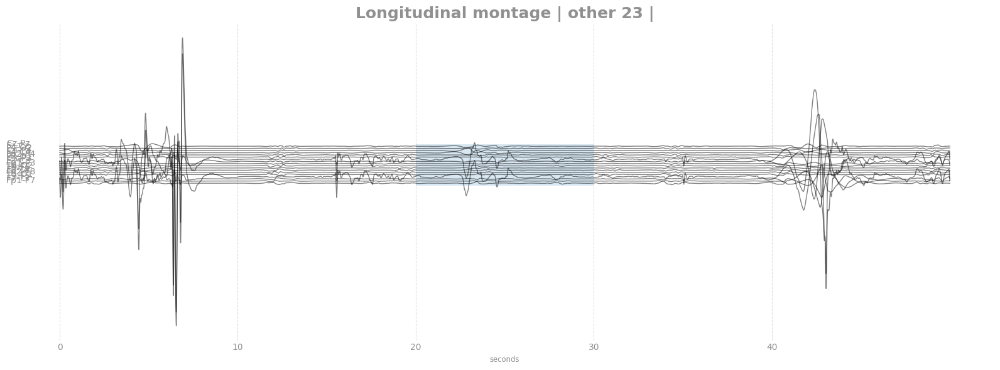

590374806


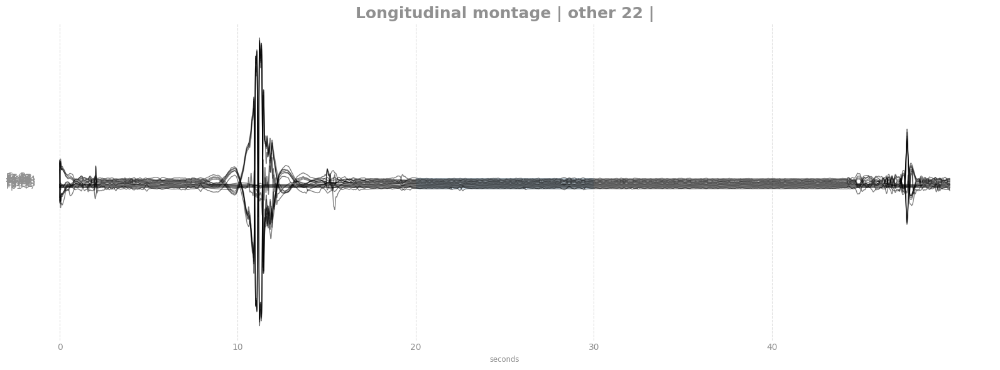

811958440


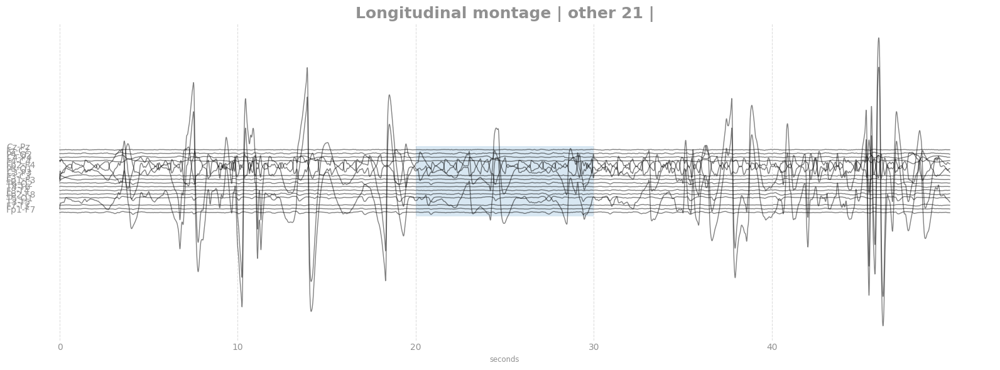

936283997


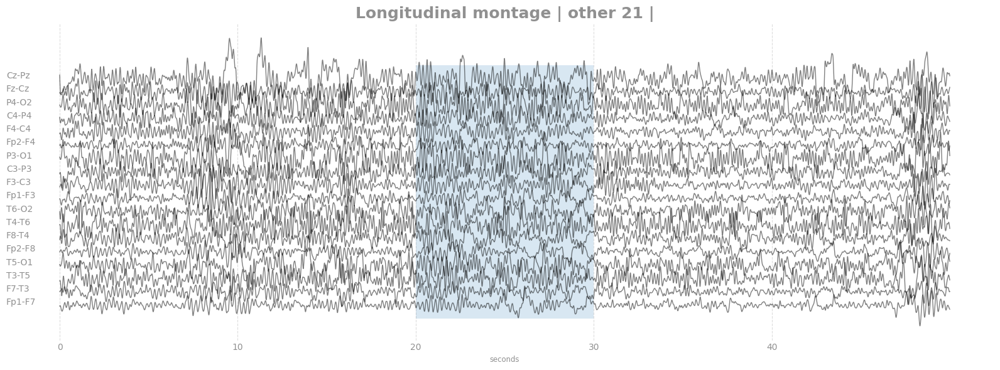

2713014975


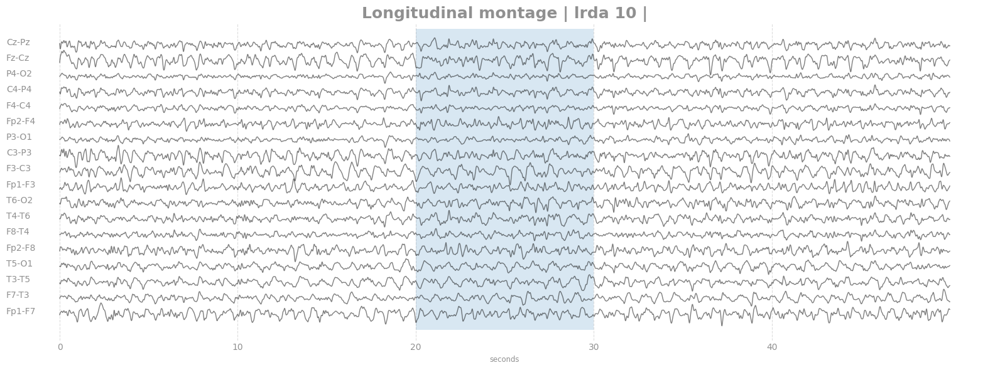

839459106


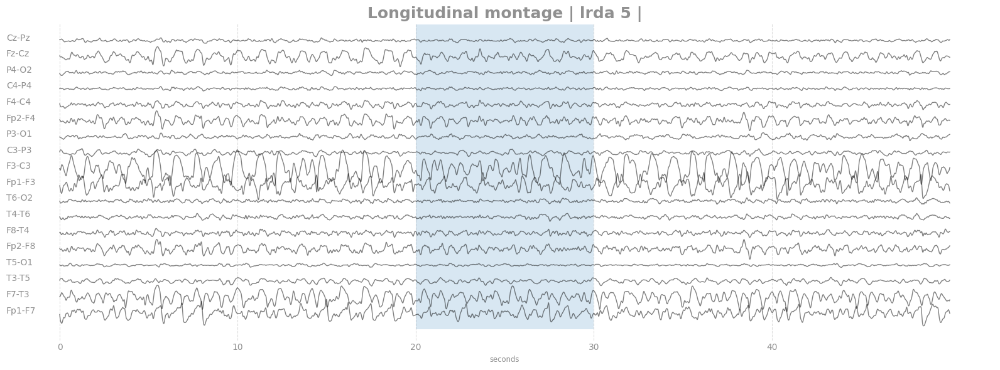

7585449


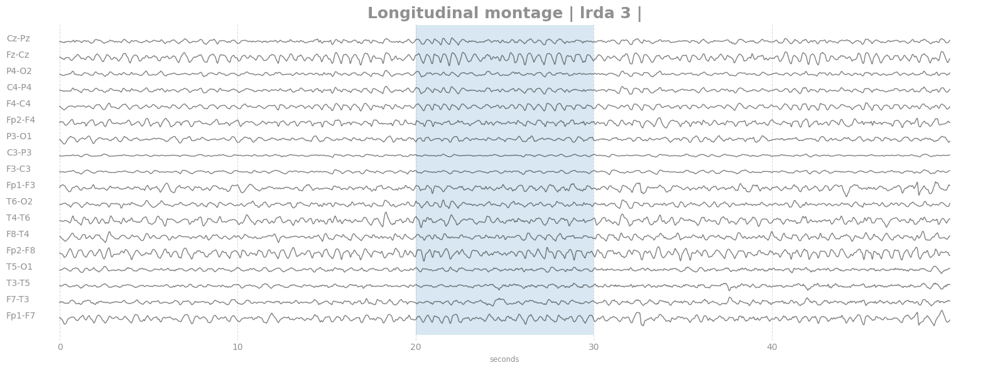

50469106


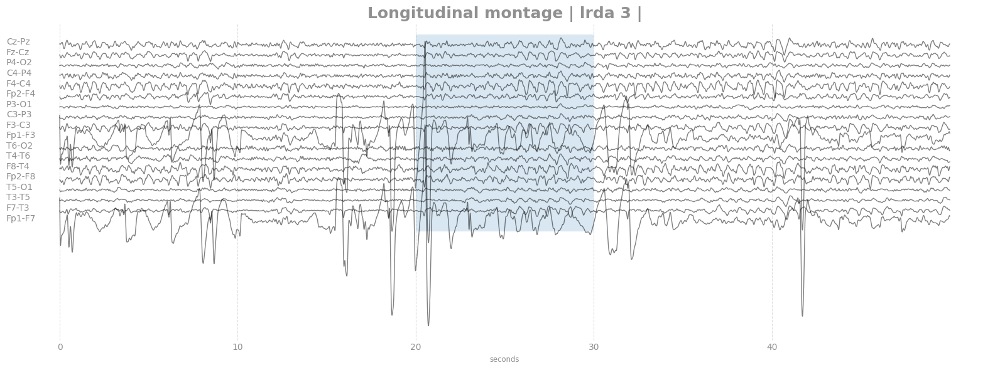

1317431280


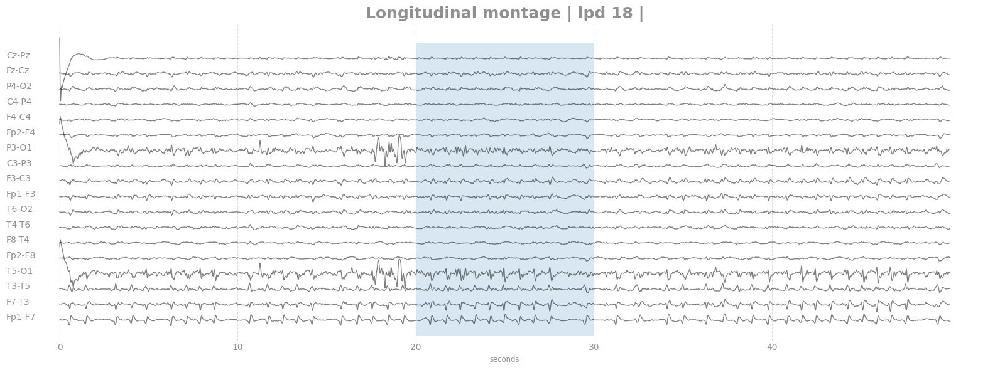

1898956741


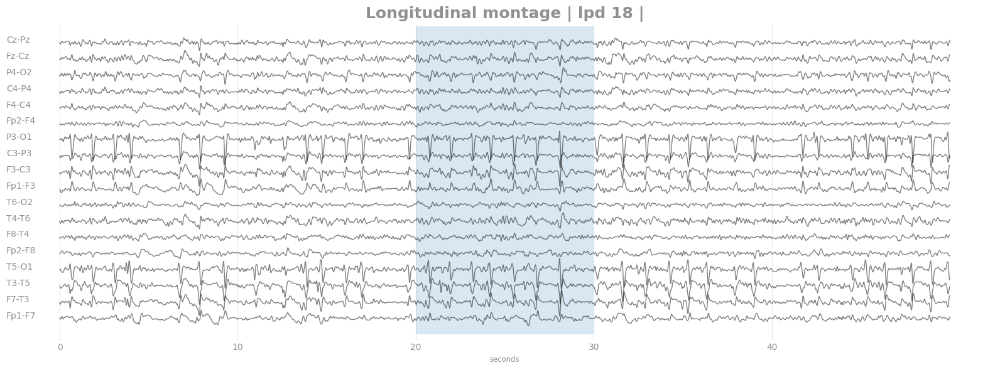

4221431176


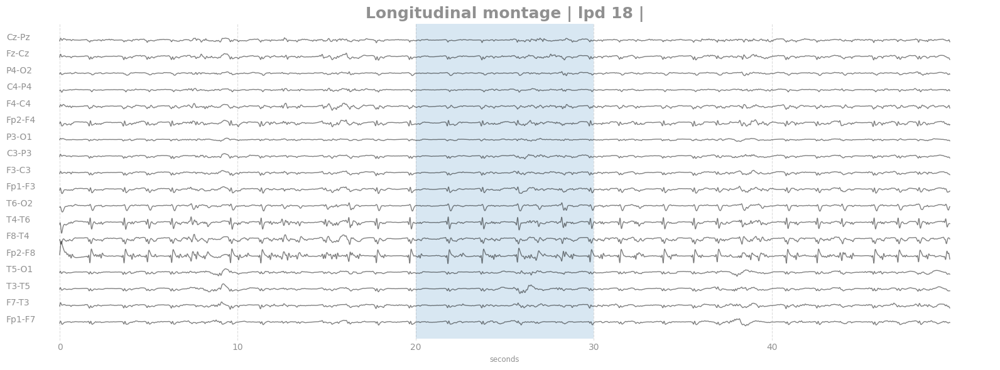

35755743


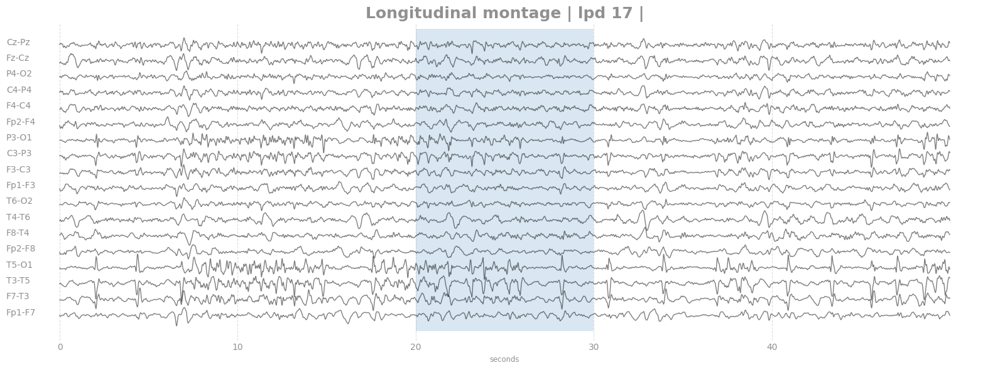

167136080


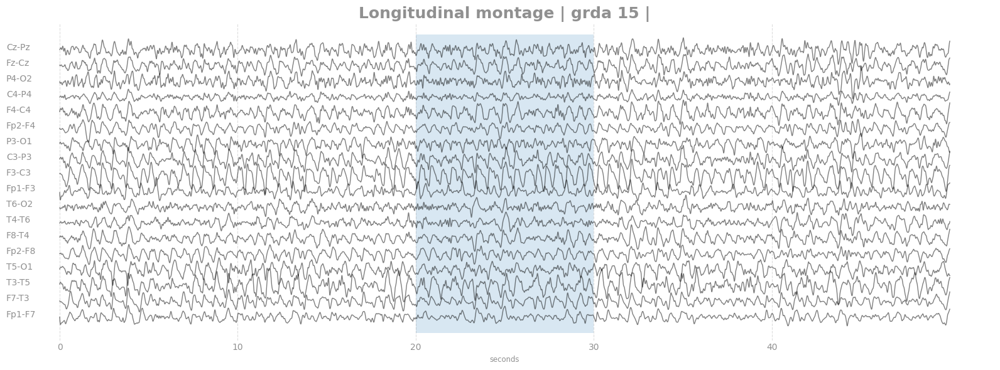

944845698


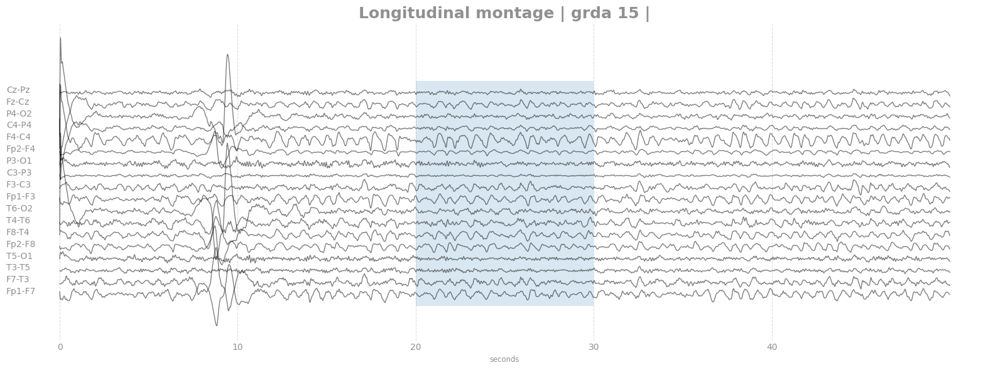

963265939


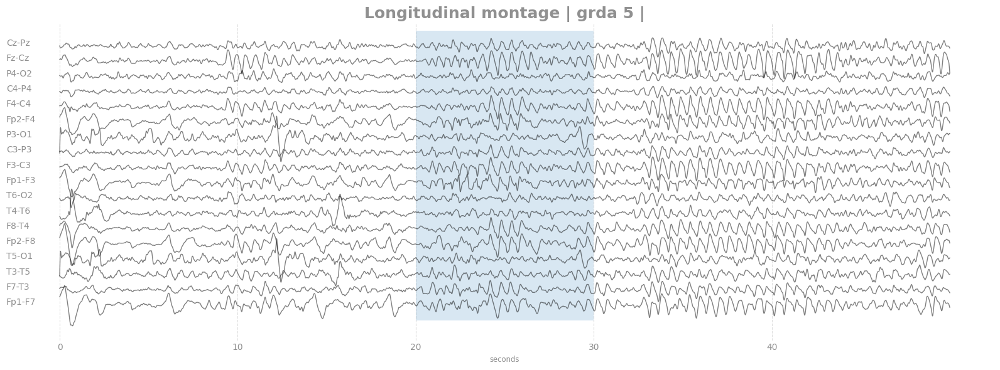

5168624


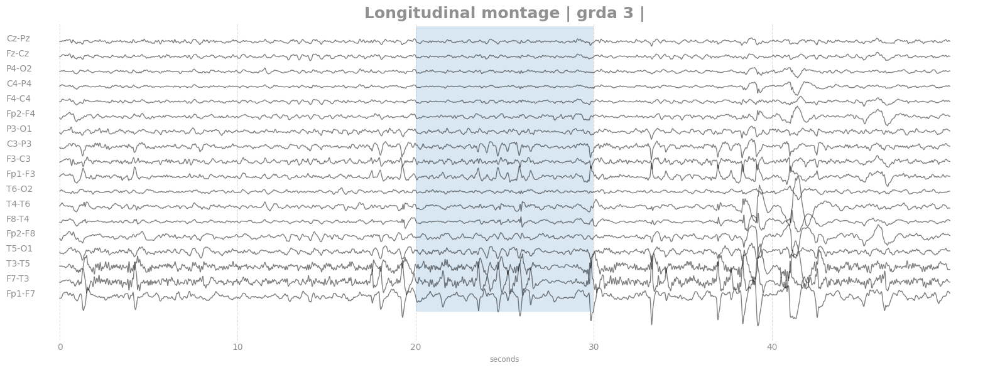

1058173302


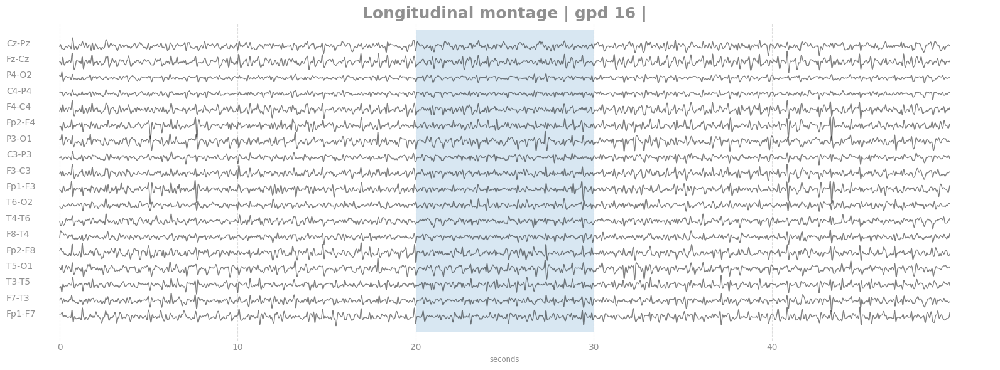

1300795281


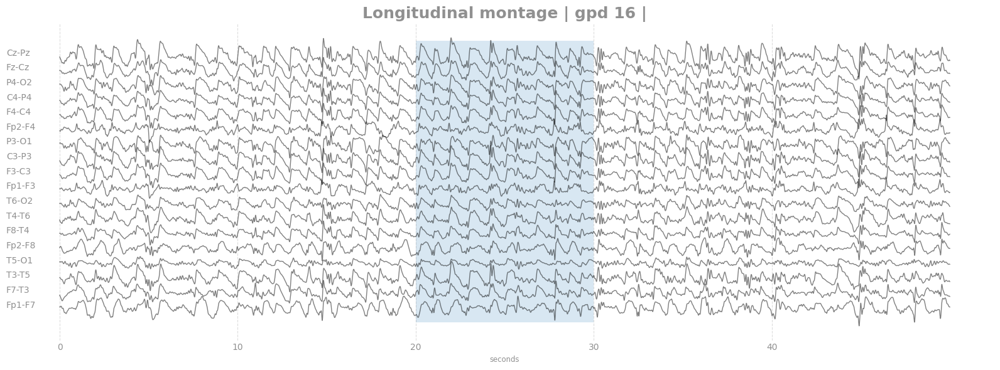

1463717064


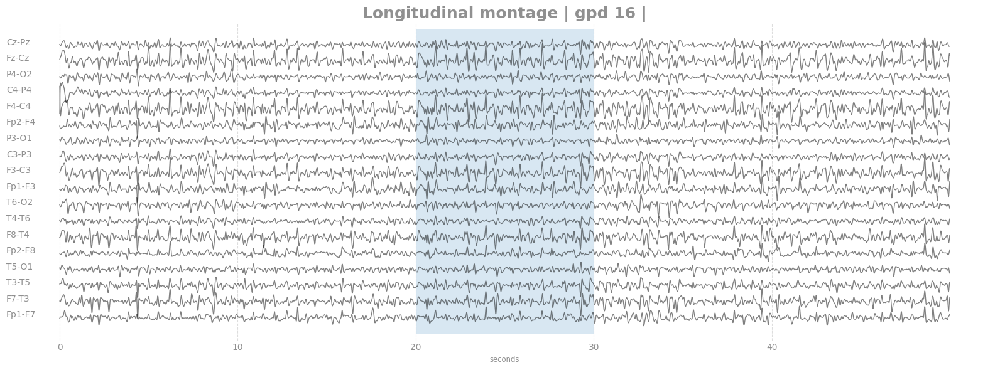

1606805366


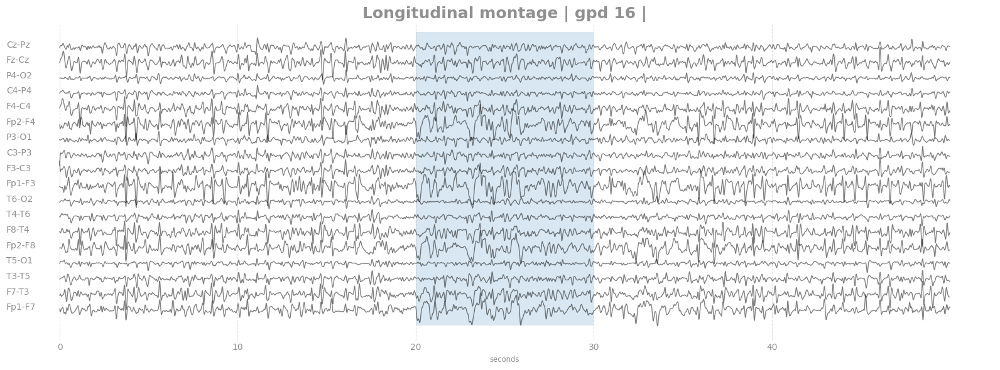

In [8]:
def filter_eeg(eeg):
    b, a = signal.butter(N=4, Wn=[0.5, 10], btype='band', fs=SR)
    filtered_data = signal.filtfilt(b, a, eeg.values, axis=0)
    return pd.DataFrame(filtered_data, columns=eeg.columns)

path_eeg = 'data/train_eegs/'

eps = 1e-10

for index, row in df_ideal.iterrows():
    print(row['eeg_id'])
    
    label = get_diagnosis(row.iloc[-6:].to_dict())
    eeg = pd.read_parquet(path_eeg + f'{row["eeg_id"]}.parquet').drop('EKG', axis=1).fillna(0)

    eeg_filt = filter_eeg(eeg)
    db_montage = get_double_banana_montage(eeg_filt)
    display_eegs(db_montage / 10., 'Longitudinal montage ' + label)

# Average over regions

2088807520


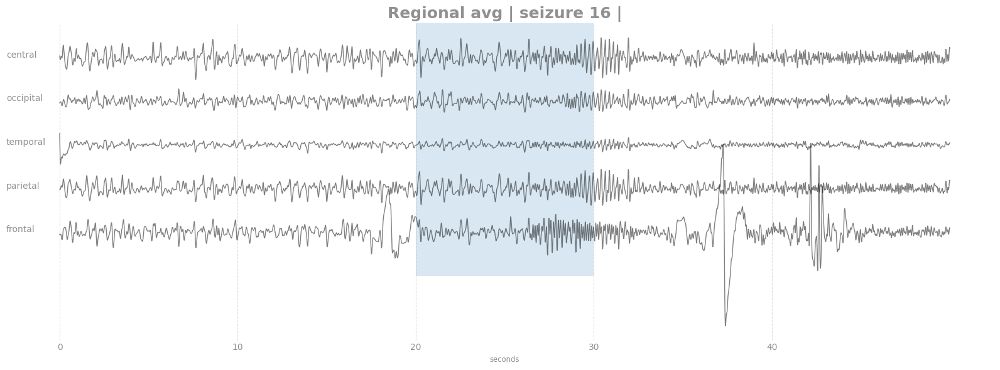

3030710864


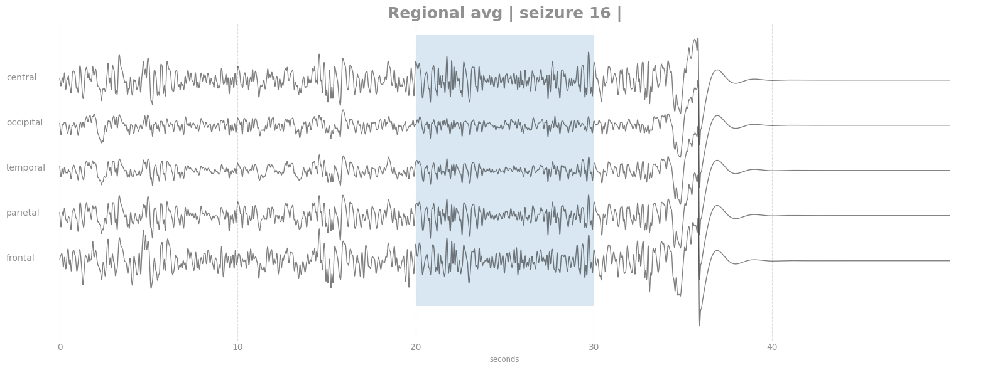

241433122


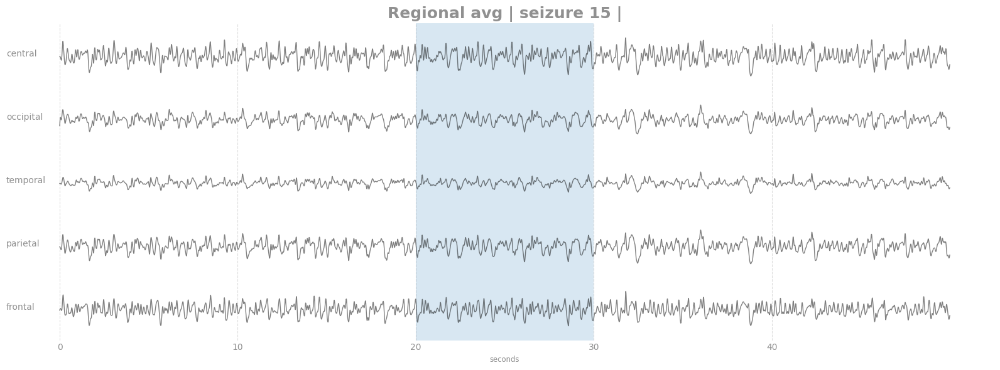

794842413


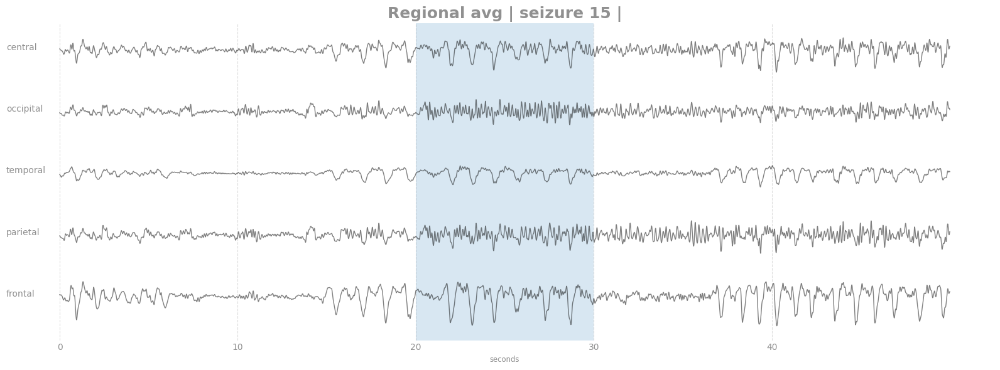

658623458


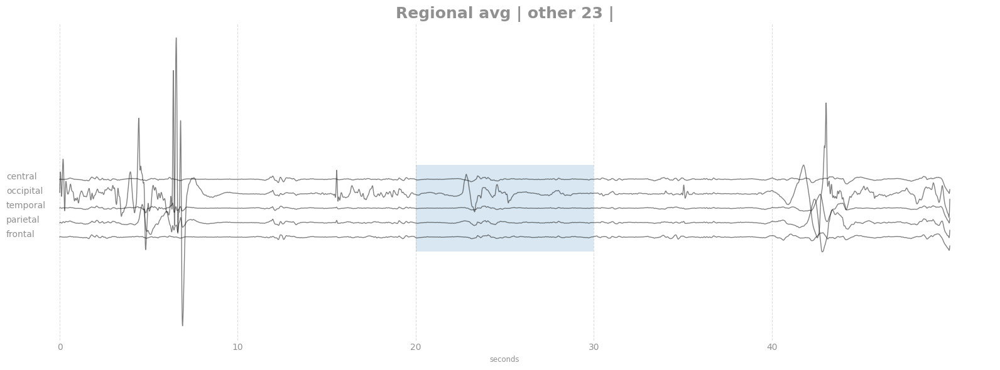

590374806


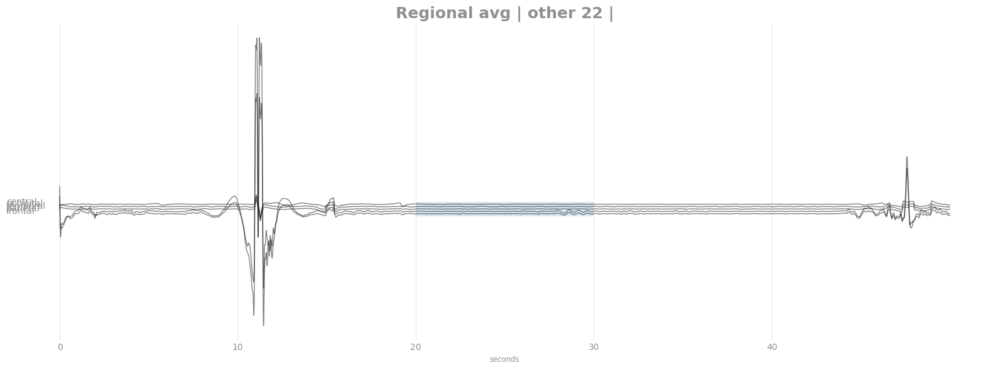

811958440


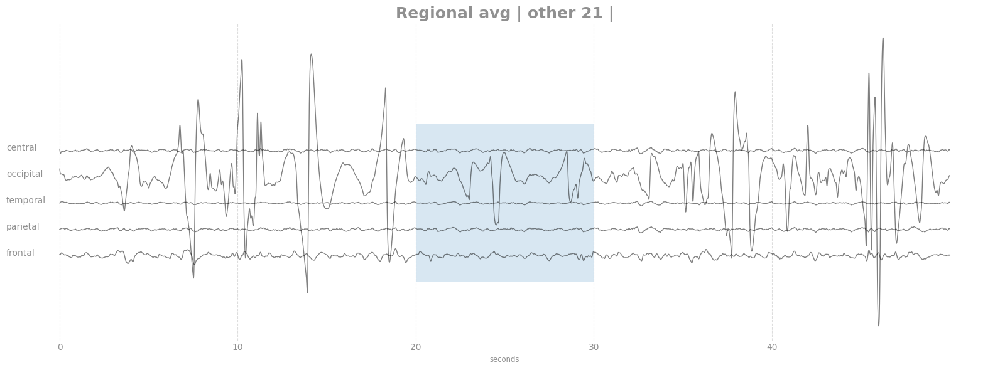

936283997


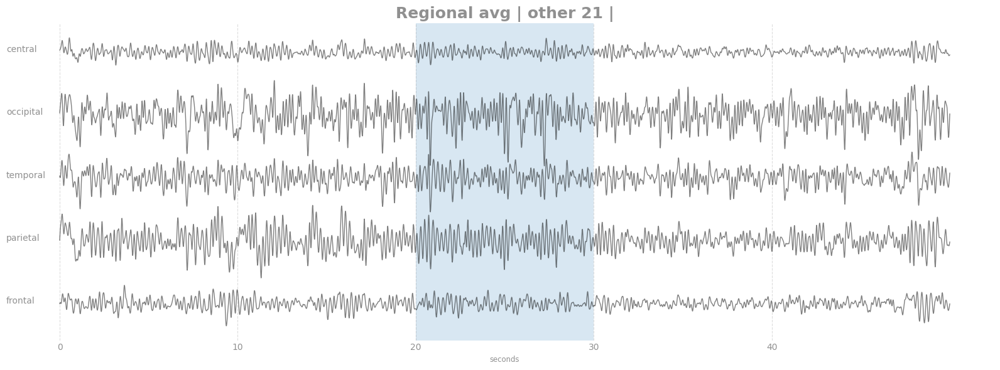

2713014975


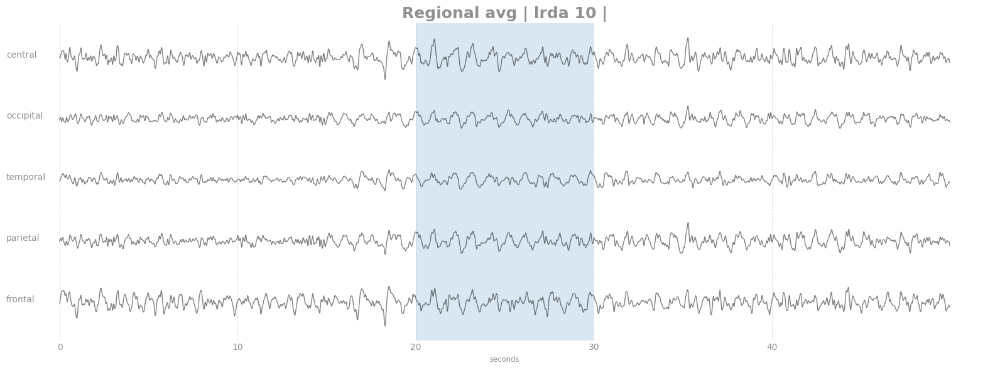

839459106


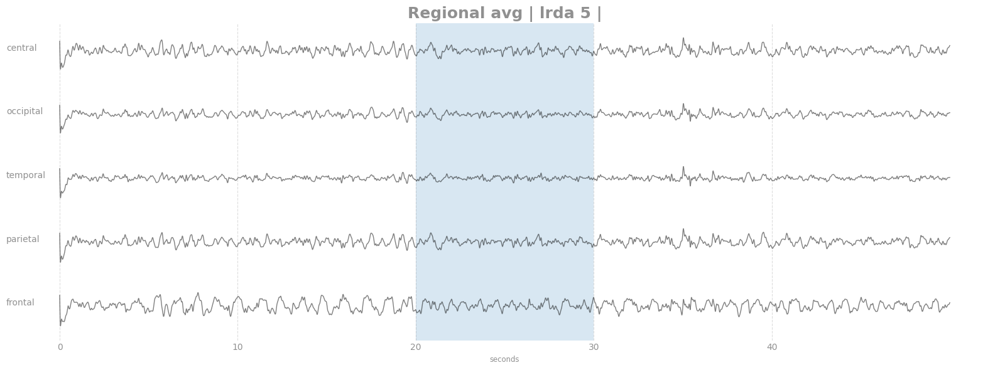

7585449


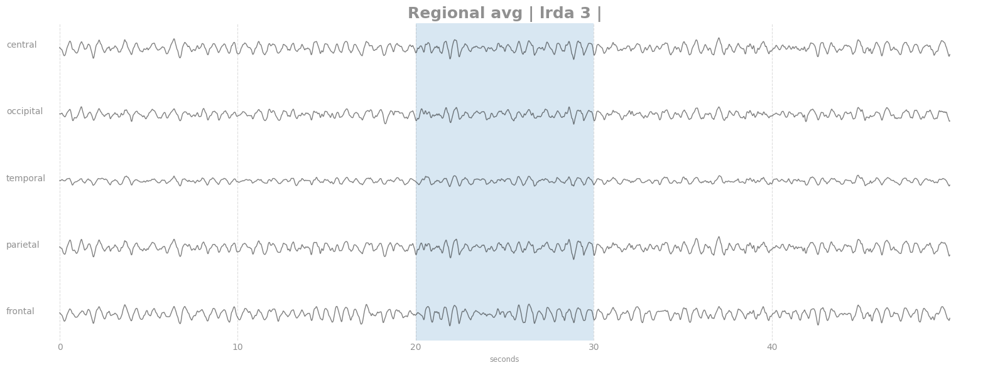

50469106


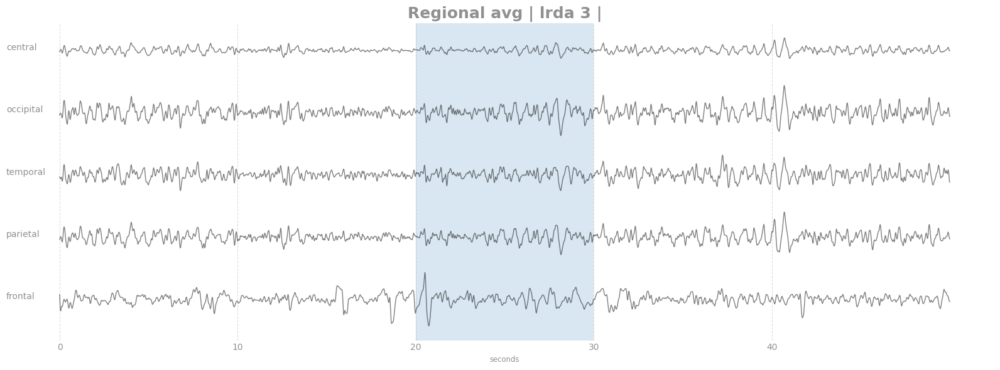

1317431280


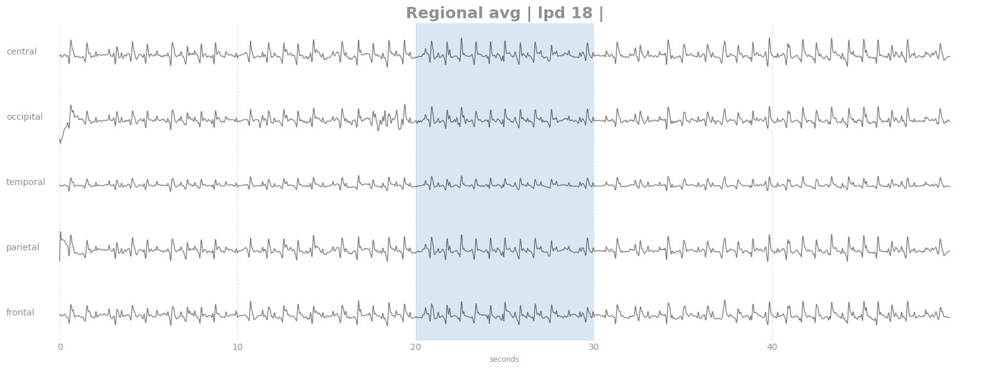

1898956741


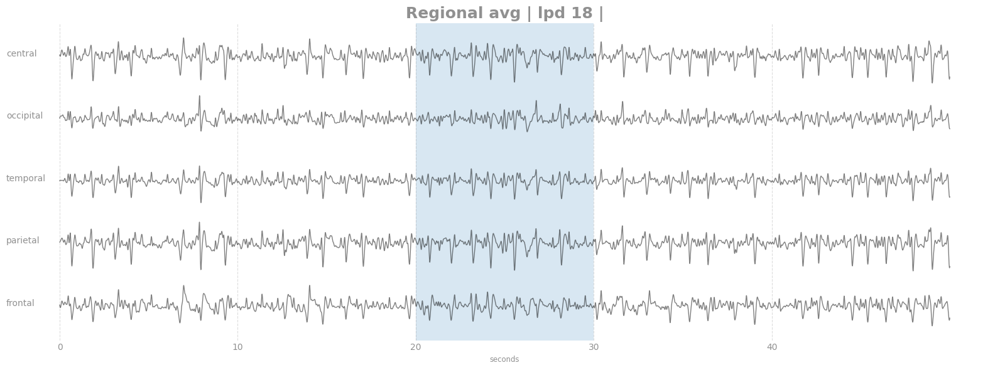

4221431176


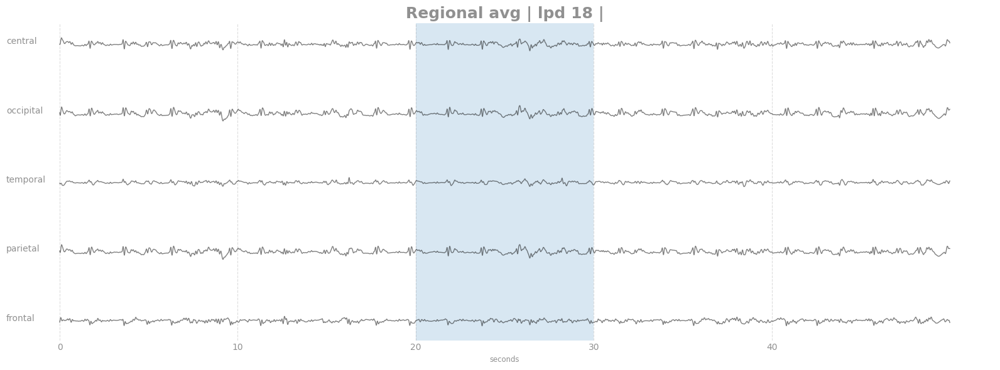

35755743


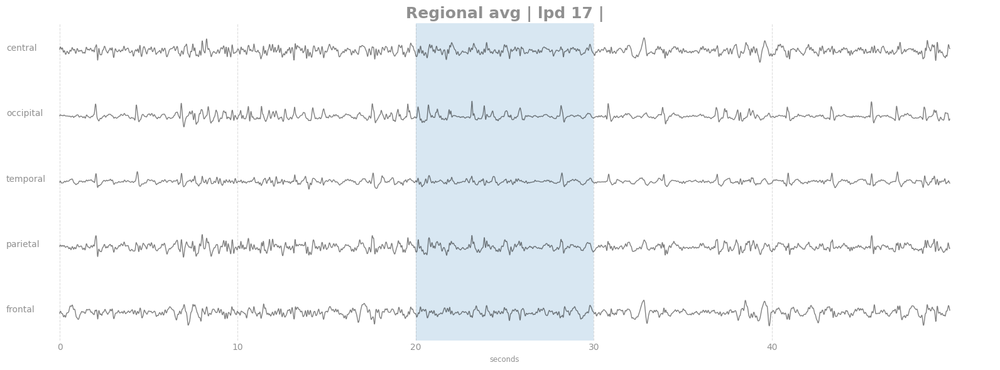

167136080


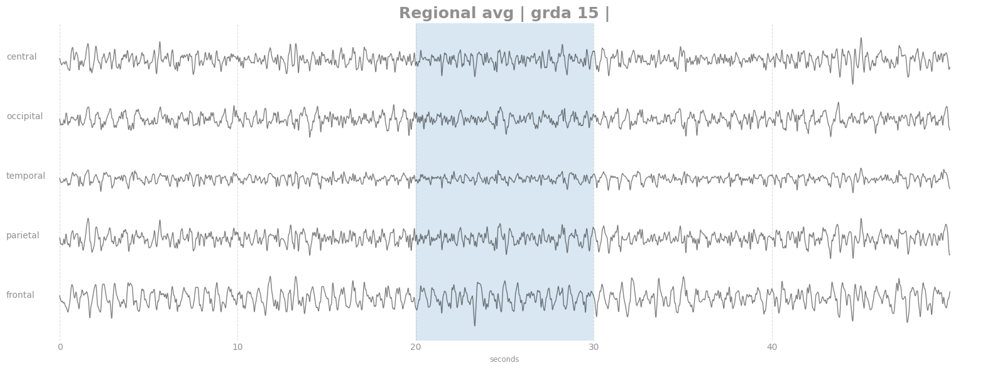

944845698


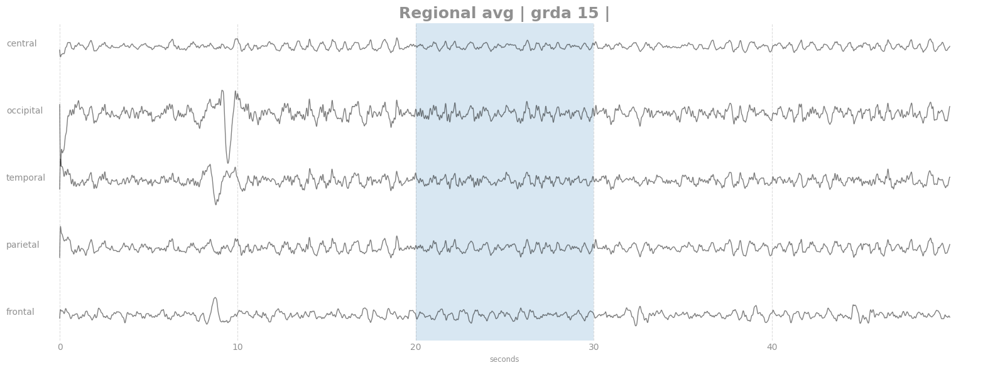

963265939


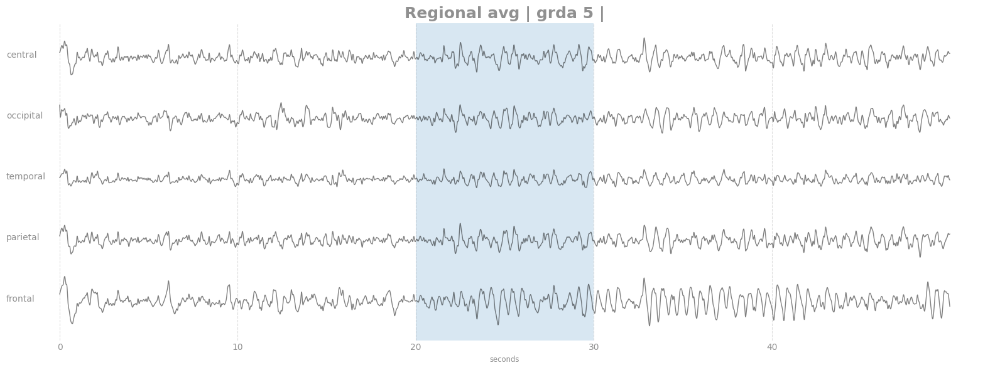

5168624


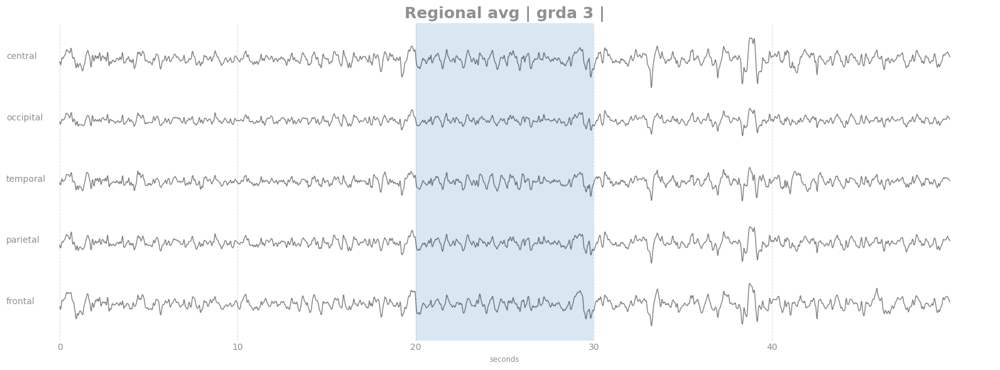

1058173302


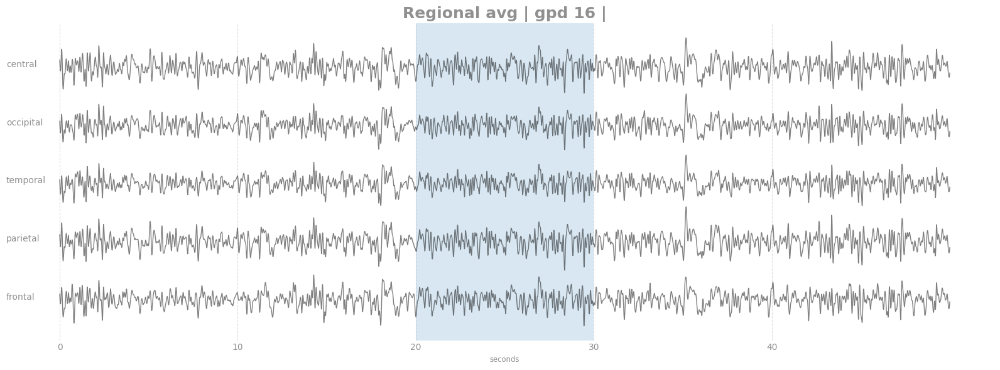

1300795281


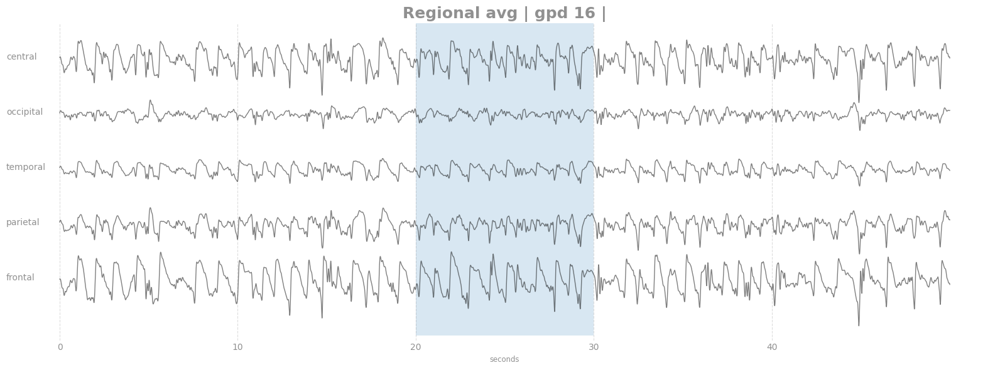

1463717064


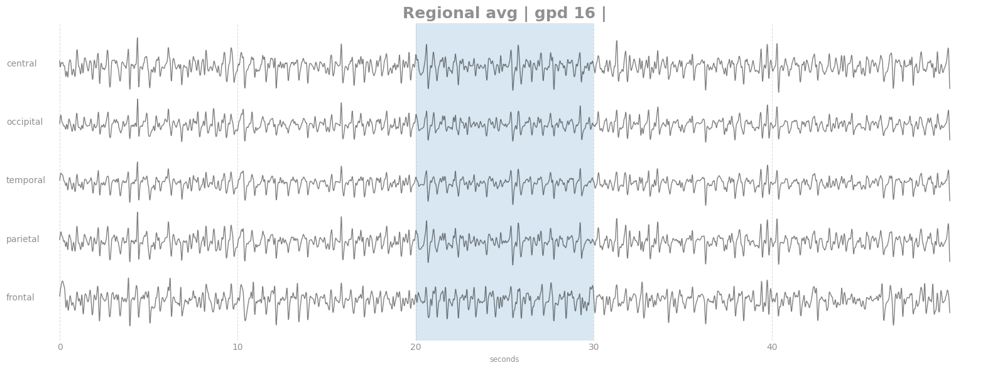

1606805366


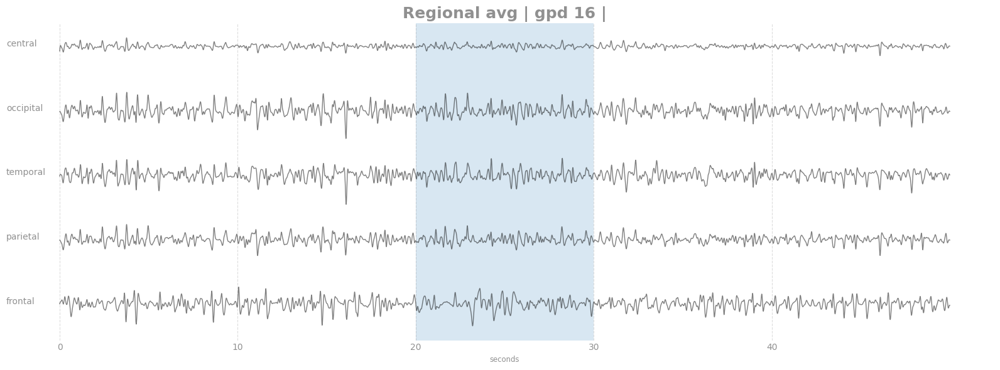

In [9]:
def get_region_averages(eeg):
    frontal =   ['Fp1', 'Fp2', 'F3', 'F4', 'F7', 'F8', 'Fz']
    parietal =  ['P3', 'P4', 'Pz']
    temporal =  ['T3', 'T4', 'T5', 'T6']
    occipital = ['O1', 'O2']
    central =   ['C3', 'C4', 'Cz']

    regions = [frontal, parietal, temporal, occipital, central]

    avg_signals = [eeg[channels].mean(axis=1) for channels in regions]
    return pd.DataFrame(np.array(avg_signals).T, columns=['frontal', 'parietal', 'temporal', 'occipital', 'central'])




for index, row in df_ideal.iterrows():
    print(row['eeg_id'])
    
    label = get_diagnosis(row.iloc[-6:].to_dict())
    eeg = pd.read_parquet(path_eeg + f'{row["eeg_id"]}.parquet').drop('EKG', axis=1).fillna(0)

    eeg_filt = filter_eeg(eeg)
    avg = get_region_averages(eeg_filt)
    display_eegs(avg / 32., 'Regional avg ' + label)